In [ ]:
from scipy import signal
import numpy as np
from sklearn.decomposition import PCA, FastICA
import os
import librosa
import librosa.display
import IPython.display as ipd
import matplotlib.pyplot as plt
import soundfile as sf

In [ ]:
from google.colab import drive
drive.mount('/gdrive')

Mounted at /gdrive


In [ ]:
os.chdir('/gdrive/My Drive/Audio_processing/23-02-2014')

In [ ]:
!ls -l

total 150598
-rw------- 1 root root  7785423 Jul  9 23:06  audio_process.ipynb
-rw------- 1 root root        0 Mar 15 20:30  audio.rttm
-rw------- 1 root root 96701996 Feb 15 22:21  Bdb001.interaction.wav
-rw------- 1 root root 13500113 Mar  5 21:53  bdb001.wav
-rw------- 1 root root    58140 Apr  1 04:22 'Copy of Untitled2.ipynb'
-rw------- 1 root root  6411533 Mar  7 14:59  Fastica.ipynb
-rw------- 1 root root   857260 Mar  2 00:07  female.wav
-rw------- 1 root root      678 Mar  7 14:58  locuteur_1.wav
-rw------- 1 root root      678 Mar  7 14:58  locuteur_2.wav
-rw------- 1 root root   772012 Mar  2 00:07  male.wav
-rw------- 1 root root  1543912 Mar  6 13:58  mixing.wav
-rw------- 1 root root 10132880 Feb 10 20:05  noise.wav
-rw------- 1 root root  1782411 Apr  1 03:24  seaker_diarizition.ipynb
-rw------- 1 root root   771978 Mar  5 20:46  Seperated11.wav
-rw------- 1 root root   771978 Mar  5 20:46  Seperated22.wav
-rw------- 1 root root   771978 Mar  5 20:50  source11.wav
-rw---

In [ ]:
voice = "voice.wav"
noise = "noise.wav"

In [ ]:
ipd.Audio(noise)

In [ ]:
ipd.Audio(voice)

In [ ]:
voice, sr = librosa.load('voice.wav')
noise, _ = librosa.load('noise.wav')

# **Audio File Information**

In [ ]:
print("voice file size : ",voice.shape )
print("noise file size : ", noise.size)

voice file size :  (661500,)
noise file size :  581415


In [ ]:
#duration of 1 sample
sample_duration_voice = 1/ sr
sample_duration_noise = 1/ _

print(f"One voice sample lasts for {sample_duration_voice:6f} seconds")
print(f"One noise sample lasts for {sample_duration_noise:6f} seconds")

One voice sample lasts for 0.000045 seconds
One noise sample lasts for 0.000045 seconds


In [ ]:
# total number of samples in audio file
tot_samples_voice = len(voice)
tot_samples_noise = len(noise)

print("total number of samples in voice file size : ", tot_samples_voice)
print("total number of samples in noise file size : ", tot_samples_noise)

total number of samples in voice file size :  661500
total number of samples in noise file size :  581415


In [ ]:
#duration of the audio signal in seconds
duration_voice = sample_duration_voice * tot_samples_voice
duration_noise = sample_duration_noise * tot_samples_noise
print(f"The voice audio lasts for {duration_voice} seconds")
print(f"The noise audio lasts for {duration_noise} seconds")

The voice audio lasts for 30.0 seconds
The noise audio lasts for 26.368027210884353 seconds


#  **Audio in Time Domain**

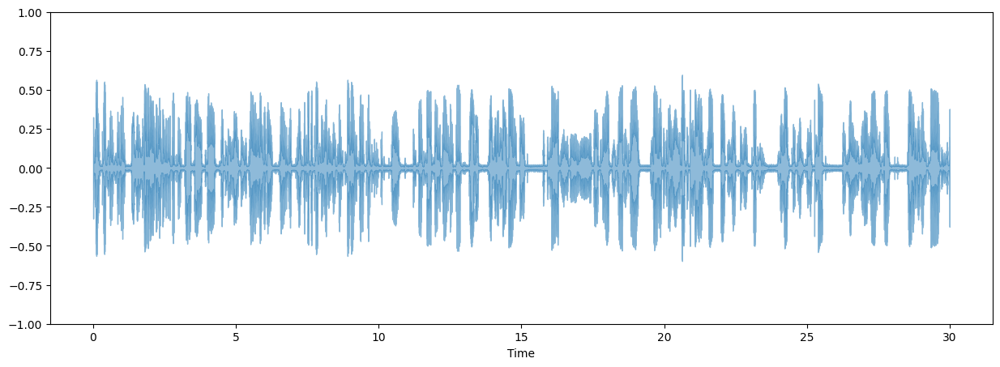

In [ ]:
plt.figure(figsize=(15, 17))

plt.subplot(3, 1, 1)
librosa.display.waveshow(voice, sr=sr, alpha=0.5)
plt.ylim((-1, 1))
#plt.title("voice of two speaker")

"""
plt.subplot(3, 1, 2)
librosa.display.waveshow(noise, sr=sr, alpha=0.5)
plt.ylim((-1, 1))
plt.title("noise")
"""


plt.show()

In [ ]:
FRAME_SIZE = 1024
HOP_LENGTH = 512

In [ ]:
#Compute amplitude envelope




def amplitude_envelope(signal, frame_size, hop_length):
    """Calculate the amplitude envelope of a signal with a given frame size nad hop length."""
    amplitude_envelope = []

    # calculate amplitude envelope for each frame
    for i in range(0, len(signal), hop_length):
        amplitude_envelope_current_frame = max(signal[i:i+frame_size])
        amplitude_envelope.append(amplitude_envelope_current_frame)

    return np.array(amplitude_envelope)

def fancy_amplitude_envelope(signal, frame_size, hop_length):
    """Fancier Python code to calculate the amplitude envelope of a signal with a given frame size."""
    return np.array([max(signal[i:i+frame_size]) for i in range(0, len(signal), hop_length)])

# number of frames in amplitude envelope
ae_voice = amplitude_envelope(voice, FRAME_SIZE, HOP_LENGTH)
ae_noise = amplitude_envelope(noise, FRAME_SIZE, HOP_LENGTH)
print(f"The voice amplitude envelope size  {len(ae_voice)} ")
print(f"The noise amplitude envelope size {len(ae_noise)} ")


The voice amplitude envelope size  1292 
The noise amplitude envelope size 1136 


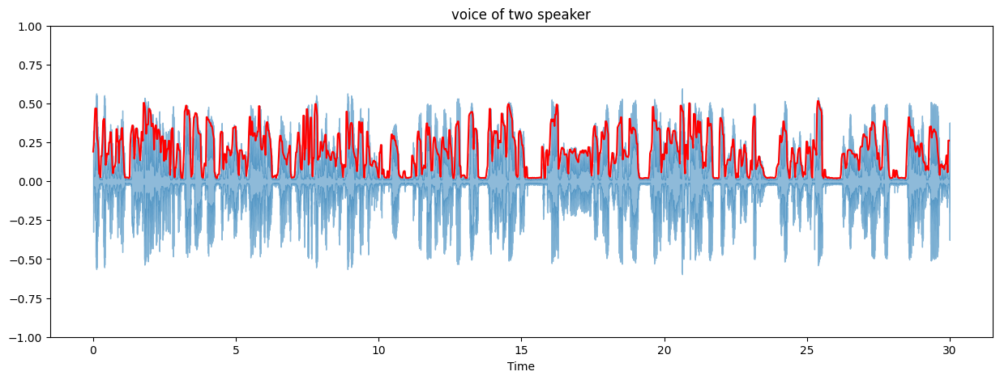

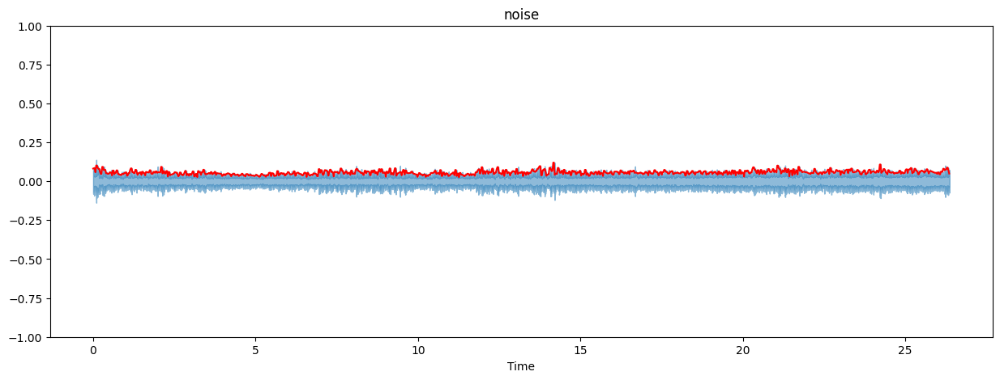

In [ ]:
#Visualizin amplitude envelope
# amplitude envelope is graphed in red

frames_voice = range(len(ae_voice))
t_voice = librosa.frames_to_time(frames_voice, hop_length=HOP_LENGTH)

frames_noise = range(len(ae_noise))
t_noise = librosa.frames_to_time(frames_noise, hop_length=HOP_LENGTH)


plt.figure(figsize=(15, 17))
ax = plt.subplot(3, 1, 1)
librosa.display.waveshow(voice, alpha=0.5)
plt.plot(t_voice, ae_voice, color="r")
plt.ylim((-1, 1))
plt.title("voice of two speaker")

plt.figure(figsize=(15, 17))
ax = plt.subplot(3, 1, 1)
librosa.display.waveshow(noise, alpha=0.5)
plt.plot(t_noise, ae_noise, color="r")
plt.ylim((-1, 1))
plt.title("noise")

plt.show()

# Root-mean-squared energy

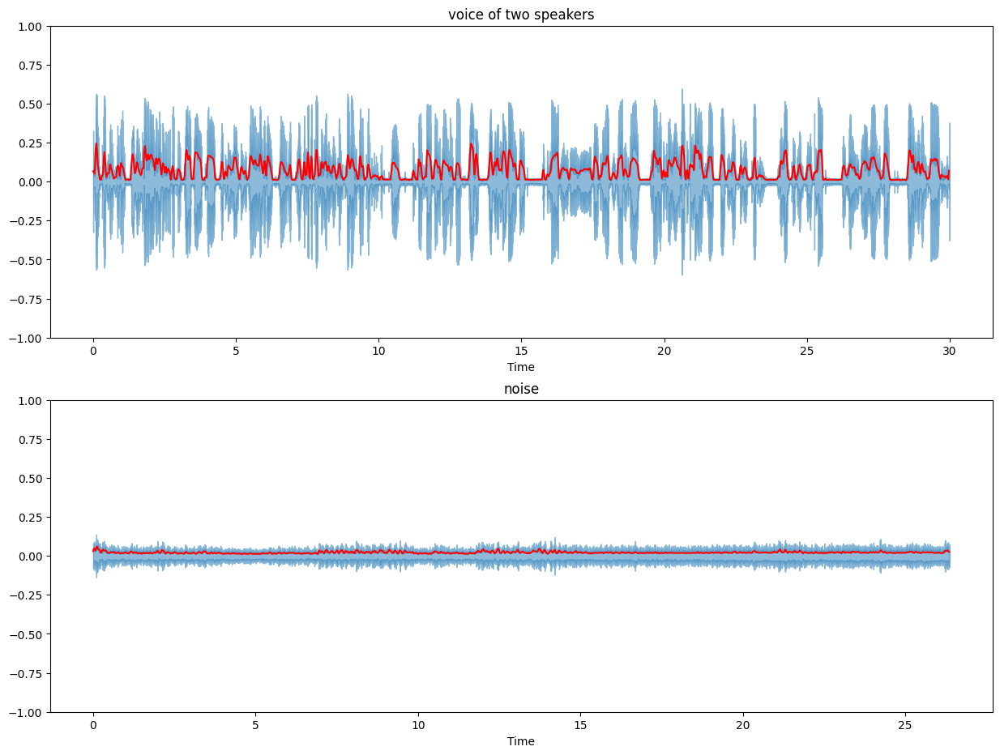

In [ ]:
# Assuming you have FRAME_SIZE and HOP_LENGTH defined somewhere in your code
rms_voice = librosa.feature.rms(y=voice, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]
rms_noise = librosa.feature.rms(y=noise, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]

frames_voice = range(len(rms_voice))
t_voice = librosa.frames_to_time(frames_voice, hop_length=HOP_LENGTH)

frames_noise = range(len(rms_noise))
t_noise = librosa.frames_to_time(frames_noise, hop_length=HOP_LENGTH)

# rms energy is graphed in red

plt.figure(figsize=(15, 17))

ax = plt.subplot(3, 1, 1)
librosa.display.waveshow(voice, alpha=0.5)
plt.plot(t_voice, rms_voice, color="r")
plt.ylim((-1, 1))
plt.title("voice of two speakers")

ax = plt.subplot(3, 1, 2)
librosa.display.waveshow(noise, alpha=0.5)
plt.plot(t_noise, rms_noise, color="r")
plt.ylim((-1, 1))
plt.title("noise")

plt.show()

# Zero-crossing rate : voice Vs noise

zero crossing rate size of voice :  1292
zero crossing rate size of noise:  1136


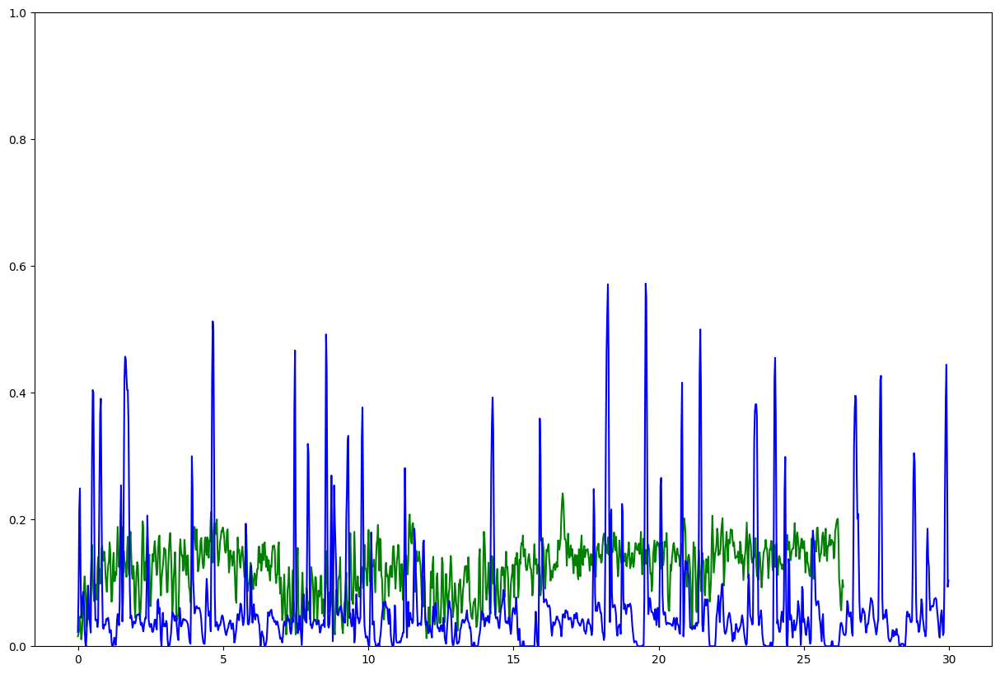

In [ ]:
zcr_voice = librosa.feature.zero_crossing_rate(voice, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]
zcr_noise = librosa.feature.zero_crossing_rate(noise, frame_length=FRAME_SIZE, hop_length=HOP_LENGTH)[0]
print("zero crossing rate size of voice : ", zcr_voice.size)
print("zero crossing rate size of noise: ", zcr_noise.size)

plt.figure(figsize=(15, 10))

plt.plot(t_noise,zcr_noise, color="g")
plt.plot(t_voice, zcr_voice, color="b")
plt.ylim(0, 1)
plt.show()

# Extracting Short-Time Fourier Transform

In [ ]:
FRAME_SIZE = 2048
HOP_SIZE = 512

In [ ]:
S_voice = librosa.stft(voice, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
S_noise = librosa.stft(noise, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
print("stft size of voice : ", S_voice.shape)
print("stft size of noise : ", S_noise.shape)
print("type voice stft : ", type(S_voice[0][0]))
print("type noise stft : ", type(S_noise[0][0]))

stft size of voice :  (1025, 1292)
stft size of noise :  (1025, 1136)
type voice stft :  <class 'numpy.complex64'>
type noise stft :  <class 'numpy.complex64'>


# Calculating the spectrogram

In [ ]:
Y_voice = np.abs(S_voice) ** 2
Y_noise = np.abs(S_noise) ** 2
print("stft**2 size of voice : ", Y_voice.shape)
print("stft**2 size of noise : ", Y_noise.shape)
print("type voice stft**2 : ", type(Y_voice[0][0]))
print("type noise stft**2 : ", type(Y_noise[0][0]))

stft**2 size of voice :  (1025, 1292)
stft**2 size of noise :  (1025, 1136)
type voice stft**2 :  <class 'numpy.float32'>
type noise stft**2 :  <class 'numpy.float32'>


# Visualizing the spectrogram

In [ ]:
def plot_spectrogram(Y, sr, hop_length, y_axis="linear"):
    plt.figure(figsize=(25, 10))
    librosa.display.specshow(Y,
                             sr=sr,
                             hop_length=hop_length,
                             x_axis="time",
                             y_axis=y_axis)
    plt.colorbar(format="%+2.f")

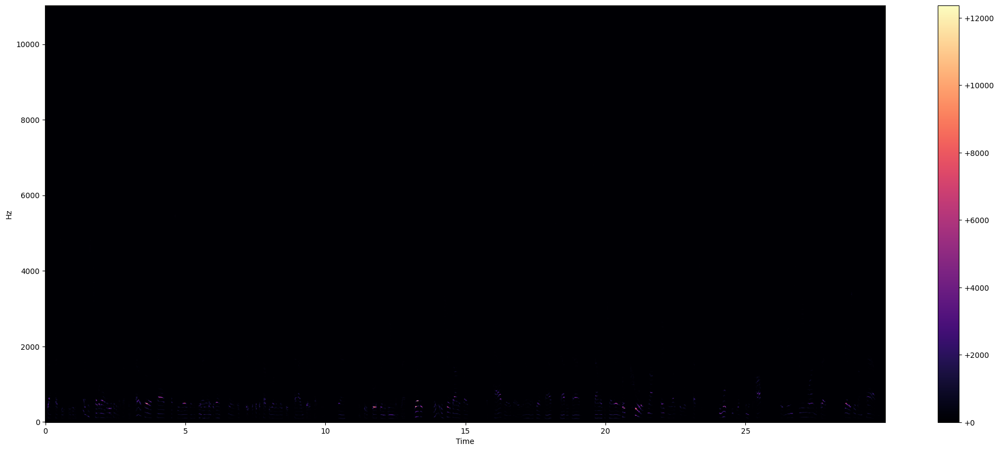

In [ ]:
plot_spectrogram(Y_voice, sr, HOP_SIZE)

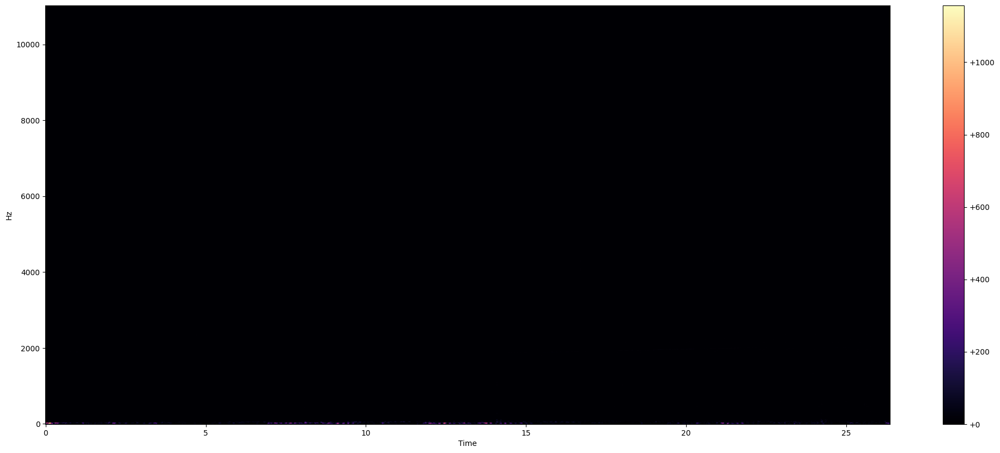

In [ ]:
plot_spectrogram(Y_noise, _, HOP_SIZE)

# Log-Amplitude Spectrogram

In [ ]:
Y_log_voice = librosa.power_to_db(Y_voice)
plot_spectrogram(Y_log_voice, sr, HOP_SIZE)

In [ ]:
Y_log_noise = librosa.power_to_db(Y_noise)
plot_spectrogram(Y_log_noise, _ , HOP_SIZE)

# Log-Frequency Spectrogram

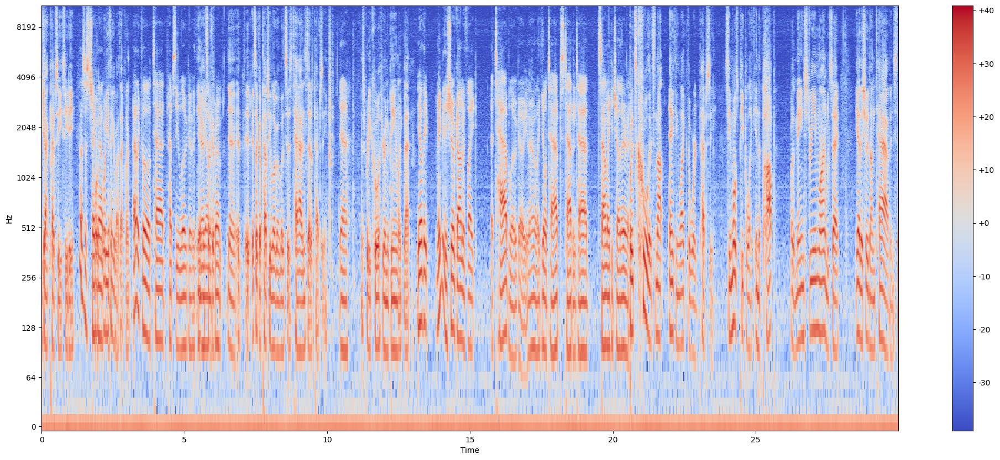

In [ ]:
plot_spectrogram(Y_log_voice, sr, HOP_SIZE, y_axis="log")

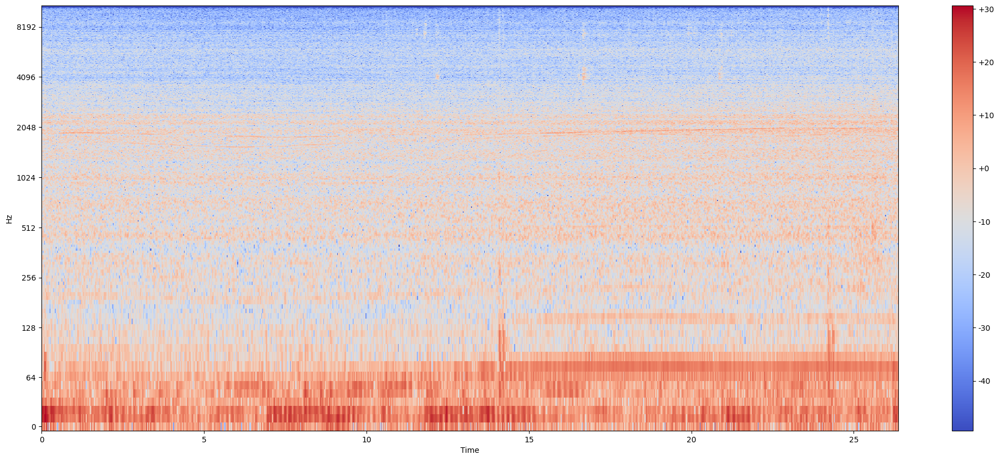

In [ ]:
plot_spectrogram(Y_log_noise, sr, HOP_SIZE, y_axis="log")

# Mel filter banks

In [ ]:
filter_banks = librosa.filters.mel(n_fft=2048, sr=22050, n_mels=10)
filter_banks.shape

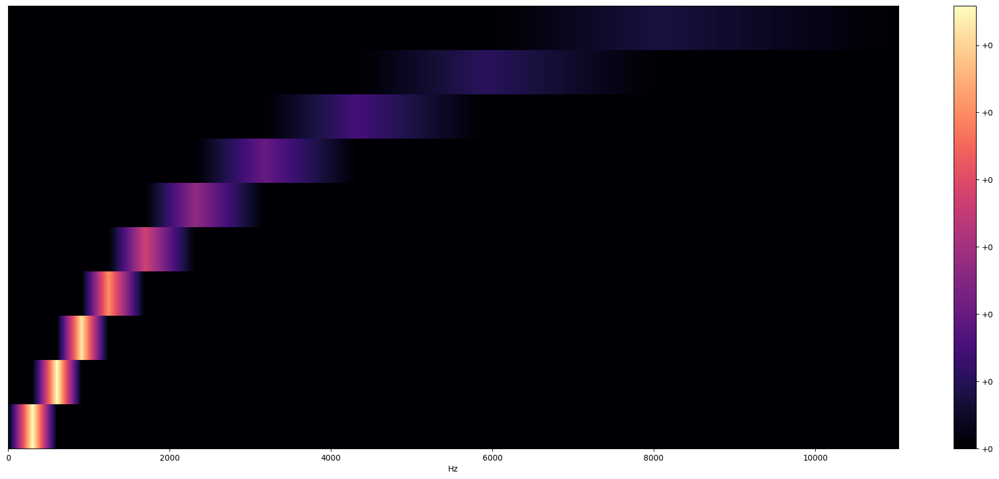

In [ ]:
plt.figure(figsize=(25, 10))
librosa.display.specshow(filter_banks,
                         sr=sr,
                         x_axis="linear")
plt.colorbar(format="%+2.f")
plt.show()

# Extracting Mel Spectrogram

In [ ]:
mel_spectrogram_voice = librosa.feature.melspectrogram(y=voice, sr=sr, n_fft=2048, hop_length=512, n_mels=10)
mel_spectrogram_noise = librosa.feature.melspectrogram(y=noise, sr=sr, n_fft=2048, hop_length=512, n_mels=10)

print("mel spectrogram voice size : ", mel_spectrogram_voice.shape)
print("mel spectrogram noise size : ", mel_spectrogram_noise.shape)

log_mel_spectrogram_voice = librosa.power_to_db(mel_spectrogram_voice)
log_mel_spectrogram_noise = librosa.power_to_db(mel_spectrogram_noise)

print("log mel spectrogram voice size : ", log_mel_spectrogram_voice.shape)
print("log mel spectrogram noise size : ", log_mel_spectrogram_noise.shape)

mel spectrogram voice size :  (10, 1292)
mel spectrogram noise size :  (10, 1136)
log mel spectrogram voice size :  (10, 1292)
log mel spectrogram noise size :  (10, 1136)


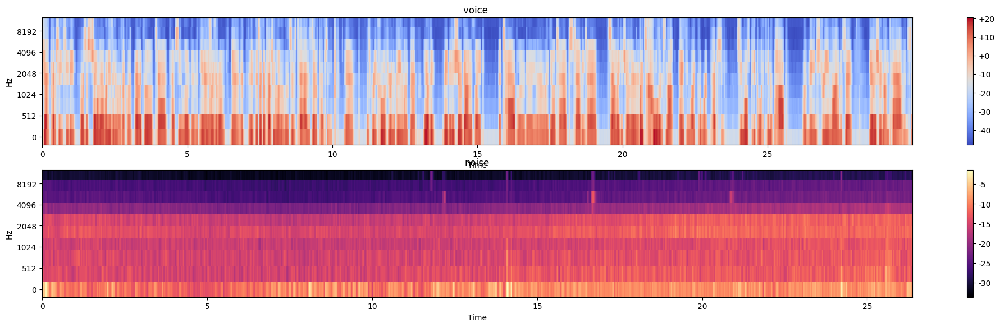

In [ ]:
plt.figure(figsize=(25, 10))

ax = plt.subplot(3, 1, 1)
librosa.display.specshow(log_mel_spectrogram_voice,
                         x_axis="time",
                         y_axis="mel",
                         sr=sr)
plt.colorbar(format="%+2.f")
plt.title("voice ")


ax = plt.subplot(3, 1, 2)
librosa.display.specshow(log_mel_spectrogram_noise,
                         x_axis="time",
                         y_axis="mel",
                         sr=sr)
plt.colorbar(format="%+2.f")
plt.title("noise")


plt.show()

# Extracting MFCCs

In [ ]:
mfccs_voice = librosa.feature.mfcc(y=voice, n_mfcc=13, sr=sr)
mfccs_noise = librosa.feature.mfcc(y=noise, n_mfcc=13, sr=sr)

print("mfcc voice size : ", mfccs_voice.shape)
print("mfcc  noise size : ", mfccs_noise.shape)

mfcc voice size :  (13, 1292)
mfcc  noise size :  (13, 1136)


# Visualising MFCCs

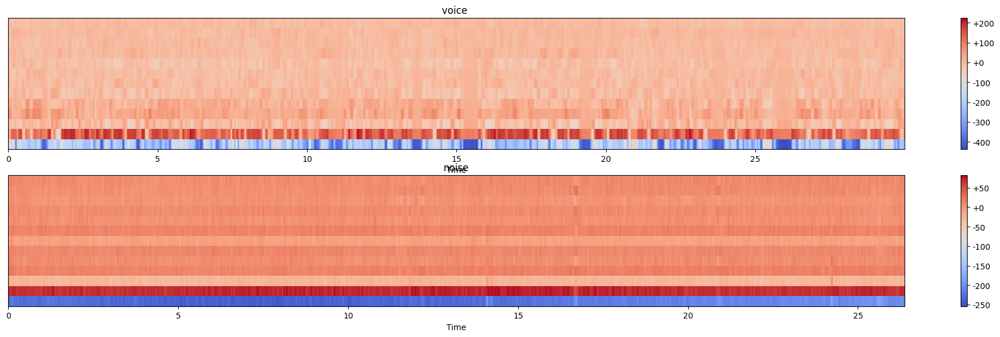

In [ ]:
plt.figure(figsize=(25, 10))

ax = plt.subplot(3, 1, 1)
librosa.display.specshow(mfccs_voice,
                         x_axis="time",
                         sr=sr)
plt.colorbar(format="%+2.f")
plt.title("voice ")


ax = plt.subplot(3, 1, 2)
librosa.display.specshow(mfccs_noise,
                         x_axis="time",
                         sr=sr)
plt.colorbar(format="%+2.f")
plt.title("noise")


plt.show()

# Deep Learning for audio

Text(0.5, 1.0, 'Power spectrum')

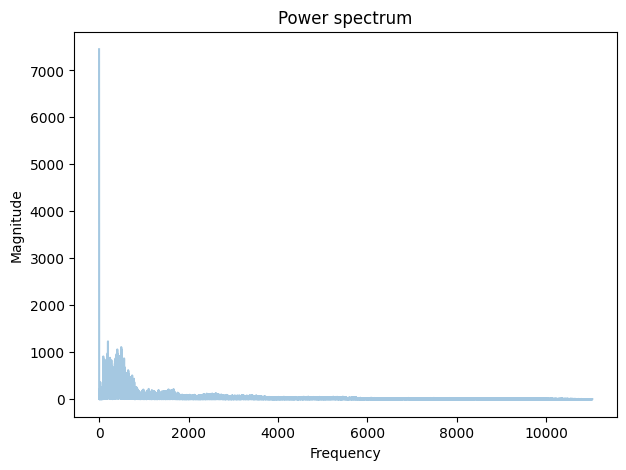

In [ ]:
# FFT -> power spectrum
# perform Fourier transform
fft = np.fft.fft(voice)
# calculate abs values on complex numbers to get magnitude
spectrum = np.abs(fft)
# create frequency variable
f = np.linspace(0, sr, len(spectrum))

# take half of the spectrum and frequency
left_spectrum = spectrum[:int(len(spectrum)/2)]
left_f = f[:int(len(spectrum)/2)]

# plot spectrum
plt.figure(figsize=(7,5))
plt.plot(left_f, left_spectrum, alpha=0.4)
plt.xlabel("Frequency")
plt.ylabel("Magnitude")
plt.title("Power spectrum")

In [ ]:
# STFT -> spectrogram
hop_length = 512 # in num. of samples
n_fft = 2048 # window in num. of samples

# calculate duration hop length and window in seconds
hop_length_duration = float(hop_length)/sr
n_fft_duration = float(n_fft)/sr

print("STFT hop length duration is: {}s".format(hop_length_duration))
print("STFT window duration is: {}s".format(n_fft_duration))

STFT hop length duration is: 0.023219954648526078s
STFT window duration is: 0.09287981859410431s


Text(0.5, 1.0, 'Spectrogram')

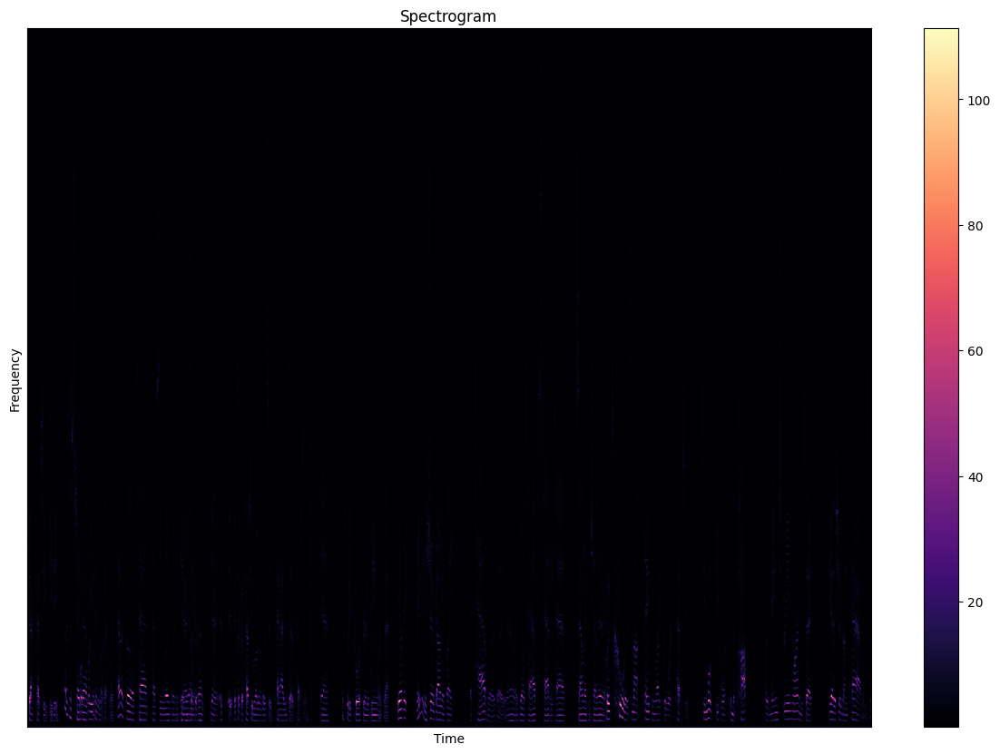

In [ ]:
# perform stft
stft = librosa.stft(voice, n_fft=n_fft, hop_length=hop_length)

# calculate abs values on complex numbers to get magnitude
spectrogram = np.abs(stft)

# display spectrogram
plt.figure(figsize=(15,10))
librosa.display.specshow(spectrogram, sr=sr, hop_length=hop_length)
plt.xlabel("Time")
plt.ylabel("Frequency")
plt.colorbar()
plt.title("Spectrogram")

Text(0.5, 1.0, 'Spectrogram (dB)')

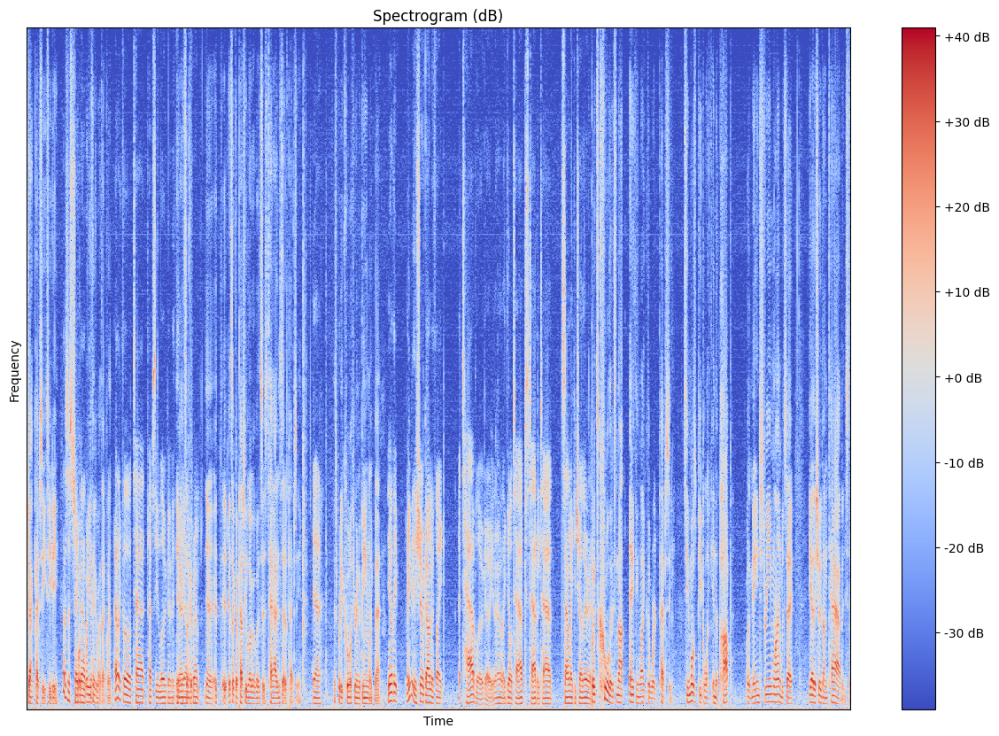

In [ ]:
# apply logarithm to cast amplitude to Decibels
log_spectrogram = librosa.amplitude_to_db(spectrogram)

plt.figure(figsize=(15,10))
librosa.display.specshow(log_spectrogram, sr=sr, hop_length=hop_length)
plt.xlabel("Time")
plt.ylabel("Frequency")
plt.colorbar(format="%+2.0f dB")
plt.title("Spectrogram (dB)")

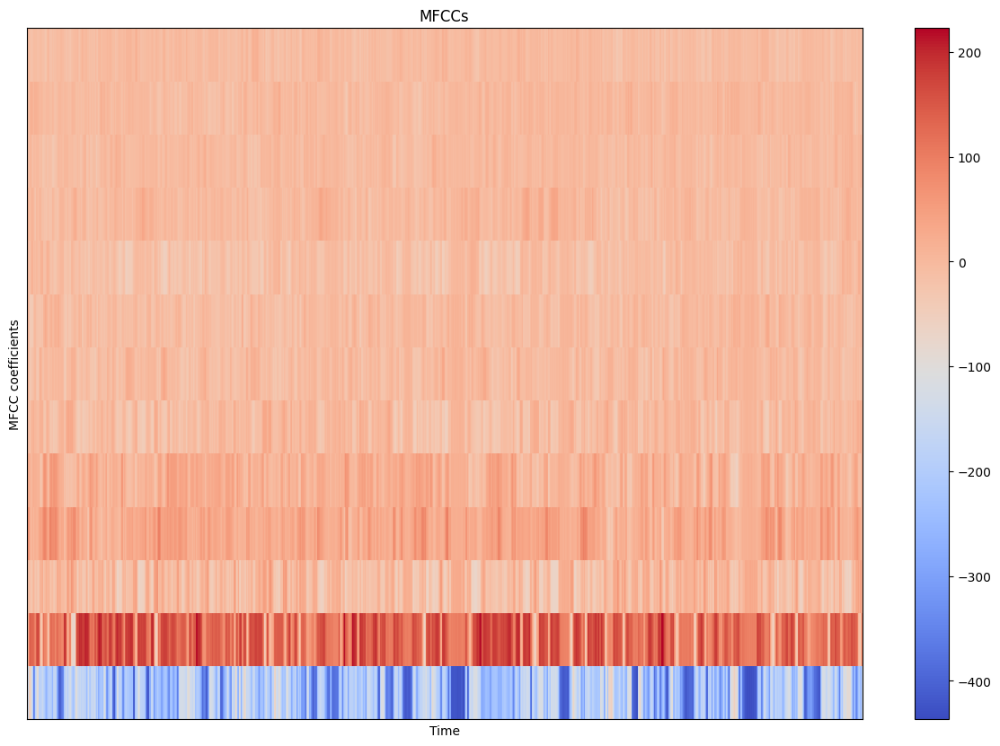

In [ ]:
# MFCCs
# extract 13 MFCCs
MFCCs = librosa.feature.mfcc(y=voice, sr=sr, n_fft=n_fft, hop_length=hop_length, n_mfcc=13)


# display MFCCs
plt.figure(figsize=(15,10))
librosa.display.specshow(MFCCs, sr=sr, hop_length=hop_length)
plt.xlabel("Time")
plt.ylabel("MFCC coefficients")
plt.colorbar()
plt.title("MFCCs")

# show plots
plt.show()